In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error
import plotly.graph_objs as go
import plotly.express as px
from sklearn.metrics import r2_score

In [2]:
ref = 'data/2017/AAPL.csv'
AAPL_2017 = pd.read_csv(ref)

In [3]:
row_close = AAPL_2017[['close']]

In [4]:
def price_change_direction_metric(ser1, ser2):
    ser1 = np.array(ser1).reshape((1, -1))[0]
    ser2 = np.array(ser2).reshape((1, -1))[0]
    change1 = np.sign(ser1[1:] - ser1[:-1])
    change2 = np.sign(ser2[1:] - ser2[:-1])
    return (change1 == change2).sum() / change1.shape[0]

Модель предсказывающая цену на актив предыдущим значением:

In [ ]:
def predict_previous_value(series):
    series = series.tolist()
    series = [series[0]] + series[:-1]
    return series

In [6]:
pred_previous_value = predict_previous_value(row_close['close'])

print(mean_absolute_percentage_error(row_close, pred_previous_value), 'MAPE')
print(price_change_direction_metric(row_close, pred_previous_value), 'Change direction')
print(r2_score(row_close, pred_previous_value), 'R2')

0.00029680378091961743 MAPE
0.4427289509274524 Change direction
0.9999632112190787 R2


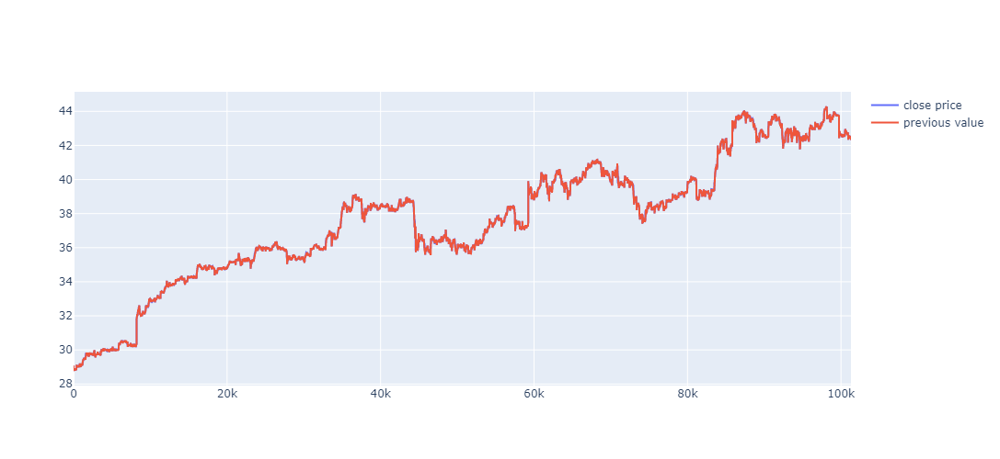

In [8]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=row_close.index, y=row_close['close'], name = 'close price'))
fig.add_trace(go.Scatter(x=row_close.index, y=pred_previous_value, name = 'previous value'))
fig.update_layout(height=500, width=1000)
fig.show()

Примитивная модель, в которой мы предсказываем цену на актив в момет времени t среднем за предыдущие n моменов

In [9]:
def predict_online_mean(series, n):
    series = series.to_list()
    pred: list[int] = []
    S: float = 0.0
    for i in range(n):
        pred.append(series[0])
        S += series[0]
    for i in range(n, len(series)):
        pred.append(S / n)
        S += series[i]
        S -= series[i-n]
    return np.array(pred)

In [10]:
pred_mean_close = predict_online_mean(row_close['close'], 150)

print(mean_absolute_percentage_error(row_close, pred_mean_close))
print(price_change_direction_metric(row_close, pred_mean_close))
print(r2_score(row_close, pred_mean_close), 'R2')

0.003181942394844975
0.4704093821261809
0.9978679242946349 R2


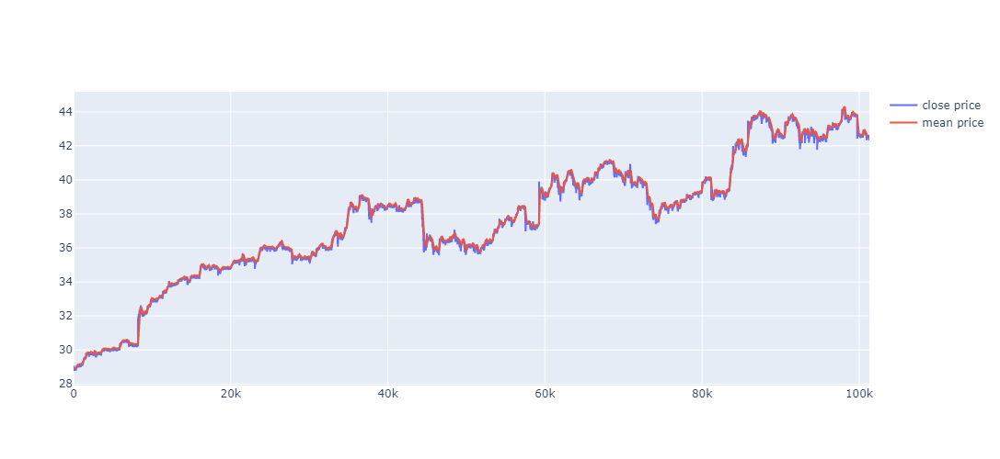

In [11]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=row_close.index, y=row_close['close'], name = 'close price'))
fig.add_trace(go.Scatter(x=row_close.index, y=pred_mean_close, name = 'mean price'))
fig.update_layout(height=500, width=1000)
fig.show()

Модель в которой цена актива в момент времени n предсказывается как экспоненциальное скользящие от исторических данных

In [12]:
def prediction_exponential_smoothing(series, alpha):
    series = series.to_list()
    pred: list[int] = [series[0]]
    for i in range(1, len(series)):
        pred.append(alpha * series[i-1] + (1 - alpha) * pred[i-1])
    return np.array(pred)

In [13]:
pred_exponential_smoothing = prediction_exponential_smoothing(row_close['close'], 0.02)

print(mean_absolute_percentage_error(row_close, pred_exponential_smoothing))
print(price_change_direction_metric(row_close, pred_exponential_smoothing))
print(r2_score(row_close, pred_exponential_smoothing), 'R2')

0.001604337022529097
0.4680993889376993
0.9991507648125116 R2


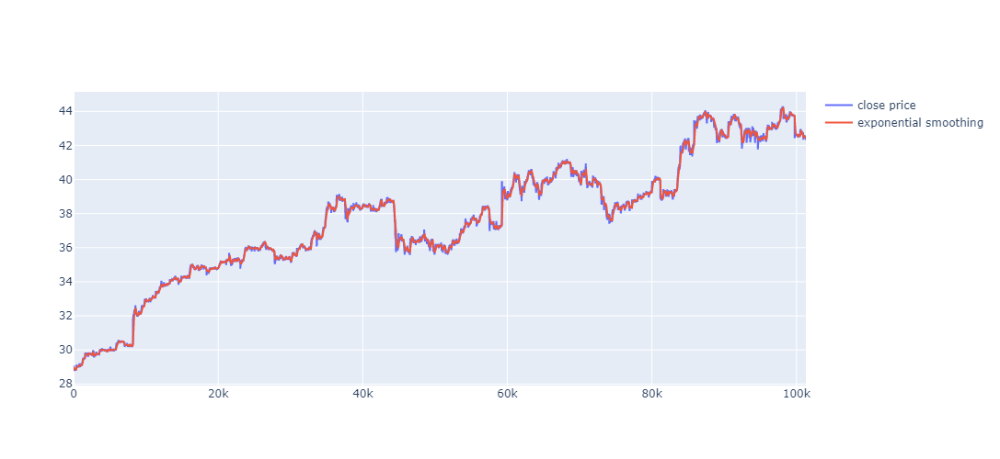

In [14]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=row_close.index, y=row_close['close'], name = 'close price'))
fig.add_trace(go.Scatter(x=row_close.index, y=pred_exponential_smoothing, name = 'exponential smoothing'))
fig.update_layout(height=500, width=1000)
fig.show()

Попытка применить статистические модели

In [1]:
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from pandas.plotting import register_matplotlib_converters
from pmdarima.arima import ADFTest
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [4]:
df = pd.read_csv('data/2017/AAPL.csv')

df['date'] = [x[:-6] for x in df['date'].to_list()]
df['date'] = pd.to_datetime(df['date'], format = "%Y-%m-%d %H:%M:%S")
df = df.set_index(pd.DatetimeIndex(df['date']))

In [6]:
data_h = 

,date,open,high,low,close,volume,vwap,timestamp,transactions,otc
date,,,,,,,,,,
2017-01-03 09:30:00,2017-01-03 09:30:00,28.9500,28.9750,28.8750,28.9713,3851984.0,28.9422,1483453800000,1970,NaN
2017-01-03 09:31:00,2017-01-03 09:31:00,28.9750,29.0625,28.9475,29.0622,997416.0,29.0088,1483453860000,1050,NaN
2017-01-03 09:32:00,2017-01-03 09:32:00,29.0625,29.0825,29.0575,29.0750,653408.0,29.0686,1483453920000,700,NaN
2017-01-03 09:33:00,2017-01-03 09:33:00,29.0750,29.0750,29.0050,29.0276,1005592.0,29.0285,1483453980000,1049,NaN
2017-01-03 09:34:00,2017-01-03 09:34:00,29.0273,29.0600,29.0273,29.0375,667760.0,29.0412,1483454040000,929,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-29 15:56:00,2017-12-29 15:56:00,42.3340,42.3400,42.3250,42.3275,1003096.0,42.3318,1514580960000,1543,NaN
2017-12-29 15:57:00,2017-12-29 15:57:00,42.3275,42.3325,42.3188,42.3225,703696.0,42.3251,1514581020000,1087,NaN
2017-12-29 15:58:00,2017-12-29 15:58:00,42.3225,42.3300,42.3188,42.3225,1226500.0,42.3237,1514581080000,2014,NaN


In [5]:
data_train = data_h[:'2017-09']
data_test = data_h['2017-10':]

NameError: name 'data_h' is not defined

Первая попытка построить ARIMA

In [298]:
import numpy as np, pandas as pd 
import statsmodels as sm
  
# Creating ARIMA model 
mymodel = sm.tsa.arima.model.ARIMA(data_h.values, order =(0, 1, 1)) 
modelfit = mymodel.fit() 
print(modelfit.summary()) 

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                 2002
Model:                 ARIMA(0, 1, 1)   Log Likelihood                1159.823
Date:                Fri, 14 Oct 2022   AIC                          -2315.645
Time:                        01:25:47   BIC                          -2304.442
Sample:                             0   HQIC                         -2311.532
                               - 2002                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.0931      0.011      8.202      0.000       0.071       0.115
sigma2         0.0184      0.000    168.645      0.000       0.018       0.019
Ljung-Box (L1) (Q):                   0.01   Jarque-

In [299]:
prediction = modelfit.predict(return_conf_int=True)

In [301]:
print(mean_absolute_percentage_error(data_h, prediction))
print(price_change_direction_metric(data_h, prediction))

0.002461862002225891
0.5442278860569715


Только на этой модели показатель price_change_direction_metric больше чем 0.5 \
Знать бы еще как она работает...

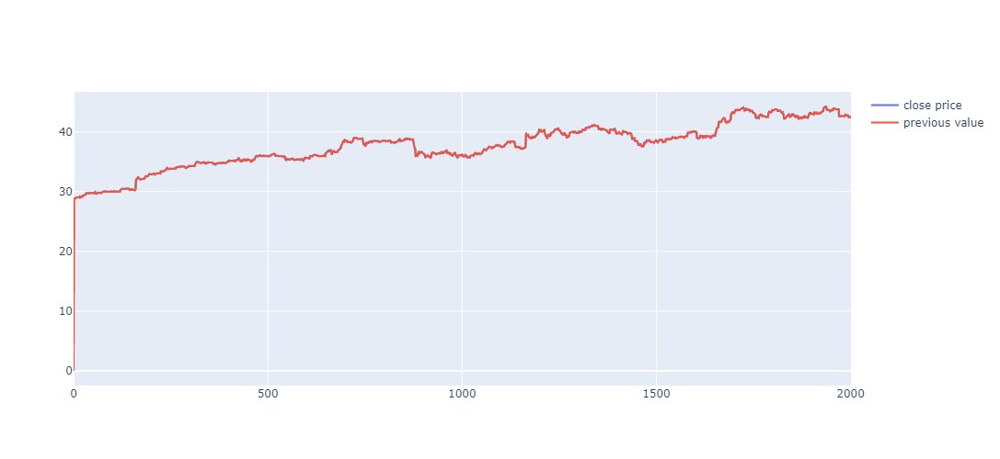

In [250]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=row_close.index, y=data_h, name = 'close price'))
fig.add_trace(go.Scatter(x=row_close.index, y=prediction, name = 'previous value'))
fig.update_layout(height=500, width=1000)
fig.show()

Вторая попытка построить ARIMA

Немного меняю логик предсказания и использую другую модель для обучения ARIMA

In [230]:
TEST_SIZE = 500
train, test = data_h.iloc[:-TEST_SIZE], data_h.iloc[-TEST_SIZE:]
x_train, x_test = np.array(range(train.shape[0])), np.array(range(train.shape[0], train.shape[0]+test.shape[0]))

In [231]:
print(train.shape, test.shape)
print(x_train.shape, x_test.shape)

(1502,) (500,)
(1502,) (500,)


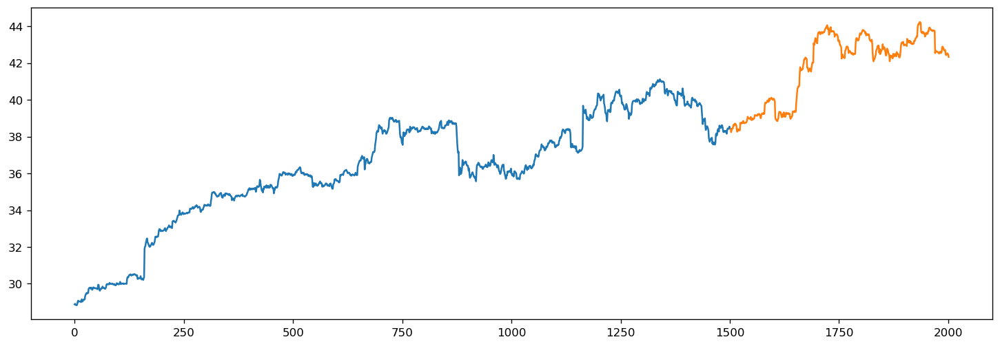

In [232]:
fig, ax = plt.subplots(1, 1, figsize=(15, 5))
ax.plot(x_train, train)
ax.plot(x_test, test)

In [306]:
from pmdarima.arima import ARIMA
from pmdarima.arima import ndiffs
from pmdarima.arima import nsdiffs

In [313]:
model = ARIMA(order=(2,1,0))
results = model.fit(train)
TEST_SIZE = 502

In [316]:
prediction, confint = model.predict(n_periods=TEST_SIZE, return_conf_int=True)
pass

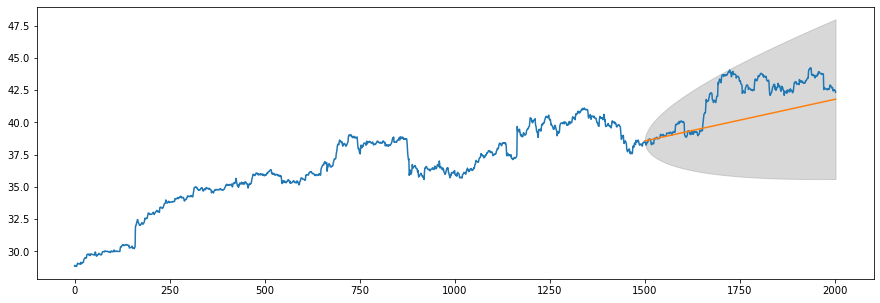

In [317]:
cf = pd.DataFrame(confint)
prediction_series = pd.Series(prediction, index=np.array(range(train.shape[0], train.shape[0]+test.shape[0])) )
fig, ax = plt.subplots(1, 1, figsize=(15, 5))
ax.plot(data_h.values)
ax.plot(prediction_series)
ax.fill_between(prediction_series.index,
                cf[0],
                cf[1],color='grey',alpha=.3)

Третья попытка построить ARIMA

In [319]:
import pmdarima
print(pmdarima.__version__)

1.8.5


In [320]:
data_h

date
2017-01-03 09:00:00    28.877980
2017-01-03 10:00:00    28.913697
2017-01-03 11:00:00    28.852605
2017-01-03 12:00:00    28.848008
2017-01-03 13:00:00    28.848570
                         ...    
2017-12-29 12:00:00    42.522932
2017-12-29 13:00:00    42.530648
2017-12-29 14:00:00    42.496175
2017-12-29 15:00:00    42.463190
2017-12-29 16:00:00    42.332500
Name: close, Length: 2002, dtype: float64

In [321]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

import pmdarima as pm
print(f"Using pmdarima {pm.__version__}")

Using pmdarima 1.8.5


In [322]:
train, test = data_h[:1500], data_h[1500:]

In [323]:
train_index, test_index = np.array(range(len(data_h)))[:1500], np.array(range(len(data_h)))[1500:]

In [324]:
auto = pm.auto_arima(train, d=1, seasonal=False, stepwise=True,
                     suppress_warnings=True, error_action="ignore", max_p=6,
                     max_order=None, trace=True)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-1822.272, Time=2.73 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1815.812, Time=1.29 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1824.501, Time=0.56 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1824.918, Time=0.73 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1814.230, Time=0.16 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1824.280, Time=1.07 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-1823.430, Time=0.74 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-1821.319, Time=1.28 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-1823.865, Time=0.20 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0] intercept
Total fit time: 8.781 seconds


In [325]:
from sklearn.metrics import mean_squared_error
from pmdarima.metrics import smape

model = auto  # seeded from the model we've already fit

def forecast_one_step():
    fc, conf_int = model.predict(n_periods=1, return_conf_int=True)
    return (
        fc.tolist()[0],
        np.asarray(conf_int).tolist()[0])

forecasts = []
confidence_intervals = []

for new_ob in test:
    fc, conf = forecast_one_step()
    forecasts.append(fc)
    confidence_intervals.append(conf)

    # Updates the existing model with a small number of MLE steps
    model.update(new_ob)

print(f"Mean squared error: {mean_squared_error(test, forecasts)}")
print(f"SMAPE: {smape(test, forecasts)}")

Mean squared error: 0.021562831072659123
SMAPE: 0.20151515394754532


In [326]:
print(mean_absolute_percentage_error(test, forecasts))
print(price_change_direction_metric(test, forecasts))

0.002015374318725651
0.5568862275449101


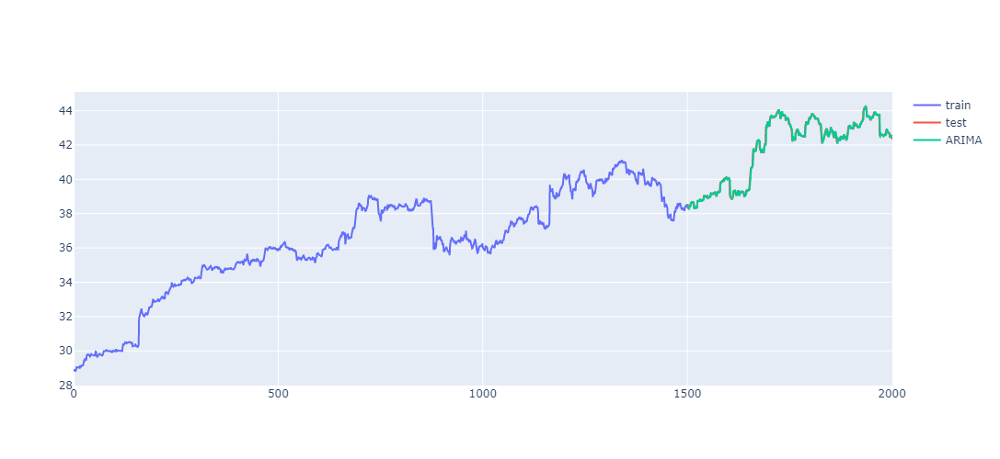

In [327]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train_index, y=train, name = 'train'))
fig.add_trace(go.Scatter(x=test_index, y=test, name = 'test'))
fig.add_trace(go.Scatter(x=test_index, y=forecasts, name = 'ARIMA'))
fig.update_layout(height=500, width=1000)
fig.show()